In [1]:
from __future__ import division, print_function
import sympy as sm
import sympy.physics.mechanics as me
import numpy as np
me.init_vprinting()
import sys
sys.path.append(
    "/Users/shenshen/drake-build/install/lib/python3.7/site-packages")
from pydrake.all import (Polynomial, Variable, Evaluate, Substitute,
                         MathematicalProgram, MosekSolver)
from veril.sample_variety import coordinate_ring_transform, check_genericity, balancing_V
from scipy.integrate import odeint
from matplotlib import animation
from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
import itertools
import os
from sympy import sin, cos

import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.pyplot import cm
import matplotlib.lines as mlines

In [2]:
# Model:
def Dubins_original():
    l = 1
    q = me.dynamicsymbols('q:{}'.format(3))  # Generalized coordinates
    f = me.dynamicsymbols('f:{}'.format(2))      # Force applied to the cart
    t = sm.symbols('t')                     # Gravity and time

    equilibrium_point = np.zeros(5,)
    equilibrium_dict = dict(zip(q + f, equilibrium_point))
    print('orig coordiante fixed pt %s' % equilibrium_dict)

    u = [f[0] + kv * l, f[1] + l]

    qdot = sm.Matrix([u[0] - kv * l,
                      u[0] * q[-1] + u[1] - l * sm.cos(q[0]),
                      -u[0] * q[1] + l * sm.sin(q[0])])
    K = np.load('gain.npy')
    div = - np.array(q)
    # ### Turn the feedback on the small angle $\theta$ to feedback on the $\sin(\theta)$
    div_in_trig = div
    div_in_trig[0] = sin(div[0])
    feedback = np.dot(K, div_in_trig)

    qdot_cl = sm.expand_trig(sm.simplify(qdot.subs(dict(zip(f, feedback)))))

    P = np.load('P.npy')
    V = sm.expand_trig((div_in_trig).T@P@(div_in_trig))
    sm.N(V.subs(equilibrium_dict))

# def recat_state(n):
    sins = me.dynamicsymbols('s:{}'.format(1))
    coss = me.dynamicsymbols('c:{}'.format(1))
    x = sins + coss + q[1:]

    x0 = [0, 1, 0, 0]
    x0_dict = dict(zip(x, x0))
    # return x, x0_dict

# def recast_transform(n):
    T = sm.Matrix(np.zeros((4, 3)))
    for i in range(2):
        T[-i - 1, -i - 1] = sm.S(1)
    T[0, 0] = coss[0]
    T[1, 0] = - sins[0]
    # return T


# def recast_sym_subs_dict(q):
    sin_q = [sin(q[0])]
    cos_q = [cos(q[0])]
    key = sin_q + cos_q
    values = sins + coss
    q_to_x_dict = dict(zip(key, values))
    # return q_to_x_dict

    Vr = V.subs(q_to_x_dict)
    print('Vr at the fixed pt %s' % Vr.subs(x0_dict))

    f_cl = sm.simplify(T@sm.expand_trig(qdot_cl).subs(q_to_x_dict))

    return Vr, x, f_cl, qdot_cl, q

In [3]:
# Verification related
def get_Vdot(Vr, x, f_cl, x_sample_dict, trig_sample_dict):
    phi = Vr.diff((x, 1))
    this_phi = phi.subs(x_sample_dict)
    this_f = f_cl.subs(x_sample_dict)

    this_Vdot = this_phi@sm.matrix2numpy(this_f)
    return this_Vdot

def get_monomials(x, deg, rm_one):
    c = 1
    _ = itertools.combinations_with_replacement(np.append(c, x), deg)
    basis = [np.prod(j) for j in _]
    if rm_one:
        basis = basis[1:]
    return (basis[:: -1])

def load_x_and_y():
    xx = np.load(folder + 'samples.npy')
    Y = np.load(folder + 'Y.npz')
    return [xx, Y['xxd'], Y['psi'], Y['V_num']]


def solve_SDP_on_samples(Y, n=None, write_to_file=False):
    prog = MathematicalProgram()
    rho = prog.NewContinuousVariables(1, "r")[0]
    prog.AddConstraint(rho >= 0)

    [xx, xxd, psi, V] = Y
    # print('SDP V %s' % V)
    num_samples, dim_psi = psi.shape
    # print('num_samples is %s' % num_samples)
    print('dim_psi is %s' % dim_psi)
    P = prog.NewSymmetricContinuousVariables(dim_psi, "P")
    prog.AddPositiveSemidefiniteConstraint(P)
    if n is not None:
        num_samples = n
    for i in range(num_samples):
        residual = xxd[i] * (V[i] - rho) - psi[i].T@P@psi[i]
        prog.AddConstraint(residual == 0)

    prog.AddCost(-rho)
    solver = MosekSolver()
    log_file = "sampling_variety_SDP.text" if write_to_file else ""
    solver.set_stream_logging(True, log_file)
    result = solver.Solve(prog, None, None)
    # print(result.get_solution_result())
    assert result.is_success()
    P = result.GetSolution(P)
    rho = result.GetSolution(rho)
    print(rho)
    return rho, P, Y

In [4]:
# Simulation related functions
def right_hand_side(x, t):
    dx = sm.matrix2numpy(qdot_cl.subs(dict(zip(q, x))), dtype=float).T[0]
    return dx

def x_to_originial(x):
    x=x.reshape((-1,4))
    angles = np.arctan2(x[:,0], x[:,1]).reshape((-1,1))
    velocity = x[:, -2:]
    return np.hstack([angles, velocity])
def right_hand_side_4d(x0, t):
    return sm.matrix2numpy(f_cl.subs(dict(zip(x, x0))), dtype=float).T[0]

def sim_once(x0):
    x0=x0.ravel()
    t = np.linspace(0.0, 10.0, num=500)
    x = odeint(right_hand_side, x0, t)

    lines = plt.plot(t, x)
    lab = plt.xlabel('Time [sec]')
    plt.show()
    return x

def sim_4d_once():
    # x0 = [np.sin(-np.pi / 3), np.cos(-np.pi / 3), 0, 0]
    x0 = np.load('bad_sample.npy')
    t = np.linspace(0.0, 10.0, num=500)
    x = odeint(right_hand_side_4d, x0, t)
    lines = plt.plot(t, x)
    lab = plt.xlabel('Time [sec]')
    plt.legend(str(kv))
    plt.show()
    return x

In [5]:
# plotting related
import plotly.graph_objects as go

def scatter_volume(rhos, r_max=[1.2, 1.2], res=50):
    [rho1, rho2, rho3] = rhos
    theta = np.linspace(-np.pi, np.pi, res)
    X = np.linspace(-r_max[0], r_max[0], res)
    Y = np.linspace(-r_max[1], r_max[1], res)
    X, Y, Z = np.meshgrid(theta, X, Y)
    X, Y, Z = X.ravel(), Y.ravel(), Z.ravel()
#     sins = np.sin(X)
#     coss = np.cos(X)
#     samples = np.array([sins, coss, Y, Z]).T
    # values = np.array([Vr.subs(dict(zip(x, i))) for i in samples])
    # np.save('V_values', values)
    values = np.load('V_values.npy')
    # values = np.load('Vdot_values.npy')
    values[values <= rho1] = rho1
    allbad= np.load('all_bad.npy')
    bad_samples = go.Scatter3d(x=allbad[:,0],y=allbad[:,1],z=allbad[:,2], mode='markers')
    fig = go.Figure(data=[go.Volume(
        x=X.flatten(), y=Y.flatten(), z=Z.flatten(),
        value=values.flatten(),
        isomin=rho1,
        isomax=rho3,
        opacity=0.2,
        surface_count=3,
        opacityscale=[[rho1, 1], [rho2, 0.3], [rho3, .1]],
    ),bad_samples])
#     fig.update_layout(scene_xaxis_showticklabels=True,
#                   scene_yaxis_showticklabels=Fals,
#                   scene_zaxis_showticklabels=False)
    fig.show()

### Nominal KV

In [6]:
# NOMINAL KV:
kv = 1
folder = './'
n = 78
Vr, x, f_cl, qdot_cl, q = Dubins_original()

Y = load_x_and_y()
[xx, xxd, psi, V] = Y


transformed_basis, T = coordinate_ring_transform(psi)
print(check_genericity(psi[:n,]))
Y[2] = transformed_basis
rho1, P, Y = solve_SDP_on_samples(Y,n=n, write_to_file=True)
myfile = open("sampling_variety_SDP.text")
print(myfile.read())
myfile.close()
print('rho is %s' %rho1)

orig coordiante fixed pt {q0(t): 0.0, q1(t): 0.0, q2(t): 0.0, f0(t): 0.0, f1(t): 0.0}
Vr at the fixed pt 0
original_monomial_dim is 35
rank for SVD 29
coordinate_ring_transform for 120 samples
does transforming
sample rank is 77
True
dim_psi is 29
0.5794590806619532

File opened at Thu Feb 27 10:00:24 2020 by MOSEK version 9.0.96.
Problem
  Name                   :                 
  Objective sense        : min             
  Type                   : CONIC (conic optimization problem)
  Constraints            : 78              
  Cones                  : 0               
  Scalar variables       : 1               
  Matrix variables       : 1               
  Integer variables      : 0               

Optimizer started.
Presolve started.
Linear dependency checker started.
Linear dependency checker terminated.
Eliminator started.
Freed constraints in eliminator : 0
Eliminator terminated.
Eliminator - tries                  : 1                 time                   : 0.00            
L

[[ 2.41304727  0.66578499 -1.03982652]]


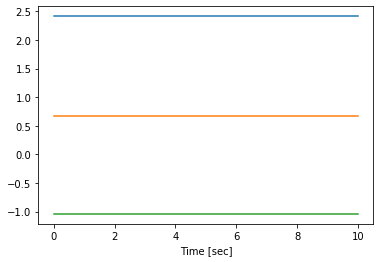

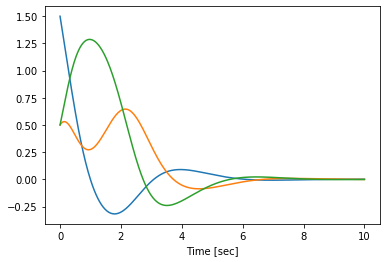

array([[ 1.50000000e+00,  5.00000000e-01,  5.00000000e-01],
       [ 1.46485302e+00,  5.08292288e-01,  5.27578874e-01],
       [ 1.42945357e+00,  5.15235309e-01,  5.55327201e-01],
       ...,
       [ 8.25207064e-04, -7.20953247e-04, -1.70139057e-03],
       [ 8.20212896e-04, -7.38898801e-04, -1.67027652e-03],
       [ 8.14778609e-04, -7.55745242e-04, -1.63891884e-03]])

In [7]:
# the bad sample is a fixed point and can't be stablized:
x0 = x_to_originial(np.load(folder + 'bad_sample.npy'))
print(x0)
sim_once(x0)
# pick a different point
x0=np.array([1.5,.5,.5])                 
sim_once(x0)

## Small KV:

In [8]:
kv = .8
folder = './LB/'
n = 66
Vr, x, f_cl, qdot_cl, q = Dubins_original()

Y = load_x_and_y()
[xx, xxd, psi, V] = Y

transformed_basis, T = coordinate_ring_transform(psi)
print(check_genericity(psi[:n,]))
Y[2] = transformed_basis
rho2, P, Y = solve_SDP_on_samples(Y,n=n, write_to_file=True)
myfile = open("sampling_variety_SDP.text")
print(myfile.read())
myfile.close()
print('rho is %s' %rho2)

orig coordiante fixed pt {q0(t): 0.0, q1(t): 0.0, q2(t): 0.0, f0(t): 0.0, f1(t): 0.0}
Vr at the fixed pt 0
original_monomial_dim is 35
rank for SVD 29
coordinate_ring_transform for 121 samples
does transforming
sample rank is 62
True
dim_psi is 29
0.6459100290575459

File opened at Thu Feb 27 10:00:30 2020 by MOSEK version 9.0.96.
Problem
  Name                   :                 
  Objective sense        : min             
  Type                   : CONIC (conic optimization problem)
  Constraints            : 66              
  Cones                  : 0               
  Scalar variables       : 1               
  Matrix variables       : 1               
  Integer variables      : 0               

Optimizer started.
Presolve started.
Linear dependency checker started.
Linear dependency checker terminated.
Eliminator started.
Freed constraints in eliminator : 0
Eliminator terminated.
Eliminator - tries                  : 1                 time                   : 0.00            
L

[[ 2.37340049  0.8685453  -1.00379293]]


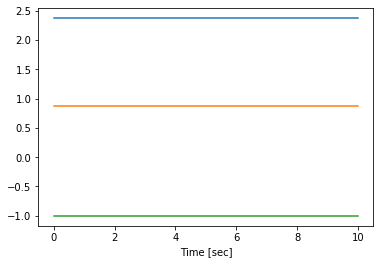

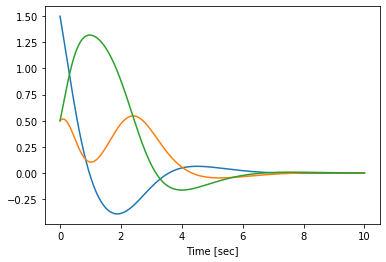

array([[ 1.50000000e+00,  5.00000000e-01,  5.00000000e-01],
       [ 1.46483037e+00,  5.06228672e-01,  5.29591786e-01],
       [ 1.42936237e+00,  5.10986607e-01,  5.59365502e-01],
       ...,
       [-5.87835029e-04,  1.31109635e-03,  3.16685543e-04],
       [-5.65245450e-04,  1.28382422e-03,  2.84302177e-04],
       [-5.43057319e-04,  1.25668764e-03,  2.52804766e-04]])

In [9]:
# the bad sample is a fixed point and can't be stablized:
x0 = x_to_originial(np.load(folder + 'bad_sample.npy'))
print(x0)
sim_once(x0)
# pick a different point
x0=np.array([1.5,.5,.5])                 
sim_once(x0)

In [10]:
# Big KV:
kv =1.2
folder = './UB/'
n=76
Vr, x, f_cl, qdot_cl, q = Dubins_original()

Y = load_x_and_y()
[xx, xxd, psi, V] = Y


transformed_basis, T = coordinate_ring_transform(psi)
print(check_genericity(psi[:n,]))
Y[2] = transformed_basis
rho3, P, Y = solve_SDP_on_samples(Y,n=n, write_to_file=True)
myfile = open("sampling_variety_SDP.text")
print(myfile.read())
myfile.close()
print('rho is %s' %rho3)

orig coordiante fixed pt {q0(t): 0.0, q1(t): 0.0, q2(t): 0.0, f0(t): 0.0, f1(t): 0.0}
Vr at the fixed pt 0
original_monomial_dim is 35
rank for SVD 29
coordinate_ring_transform for 131 samples
does transforming
sample rank is 74
True
dim_psi is 29
0.3588122937647141

File opened at Thu Feb 27 10:00:37 2020 by MOSEK version 9.0.96.
Problem
  Name                   :                 
  Objective sense        : min             
  Type                   : CONIC (conic optimization problem)
  Constraints            : 76              
  Cones                  : 0               
  Scalar variables       : 1               
  Matrix variables       : 1               
  Integer variables      : 0               

Optimizer started.
Presolve started.
Linear dependency checker started.
Linear dependency checker terminated.
Eliminator started.
Freed constraints in eliminator : 0
Eliminator terminated.
Eliminator - tries                  : 1                 time                   : 0.00            
L

[[ 2.46821882  0.51968911 -1.02269265]]


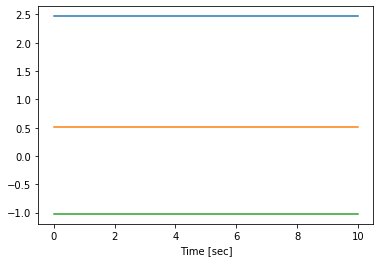

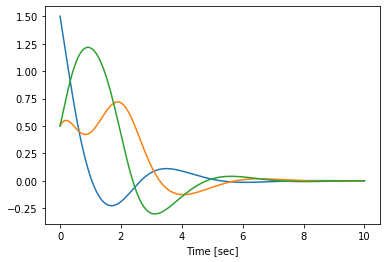

array([[ 1.50000000e+00,  5.00000000e-01,  5.00000000e-01],
       [ 1.46487570e+00,  5.10347878e-01,  5.25557668e-01],
       [ 1.42954496e+00,  5.19451967e-01,  5.51254642e-01],
       ...,
       [ 1.15422120e-04, -1.13720314e-03,  7.59720387e-04],
       [ 9.23919909e-05, -1.08990140e-03,  7.88554367e-04],
       [ 6.99757523e-05, -1.04303792e-03,  8.15802311e-04]])

In [11]:
# the bad sample is a fixed point and can't be stablized:
x0 = x_to_originial(np.load(folder + 'bad_sample.npy'))
print(x0)
sim_once(x0)
# pick a different point
x0=np.array([1.5,.5,.5])                 
sim_once(x0)

In [12]:
rhos = [rho1, rho2, rho3]
rhos.sort()
scatter_volume(rhos)